# NDVI Gapfilling in the Biscth Fire Area

This notebook displays the **gapfilling of the NDVI value** in the area affected by the Biscth fire.  

We create two historical gapfill products:  

- **L1**: the linear gapfilled product  
- **L2**: the smoothed product using a `savgol_filter` with a moving window of 14 days  

---

## Demonstration  

We demonstrate the continuous gapfilling via a GIF:  

- **Black line** → continuous linear integration  
- **Red line** → smoothing with a 14-day latency and a 14-day window length  

---


We use the `savgol_filter` because it provides the **best performance** (see [smoothing proposal](../notebook/smoothing_proposal)).  


In [1]:
from IPython.display import IFrame, Image, display
import numpy as np
import math
import zarr
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import xarray as xr
import torch
import torch.nn as nn
import pandas as pd
from scipy.signal import savgol_filter
import gc
import imageio
from io import BytesIO
import geopandas as gpd
from rasterio import features
from affine import Affine
from shapely.geometry import Point
from functions import *

This code embed the location of the Bistch fire

In [ ]:
# area location
x, y = 2694027.49, 1123239.84

# Construct the URL with your coordinates as center
url = f"https://map.geo.admin.ch/#/map?lang=de&center={x},{y}&z=6.881&topic=ech&layers=ch.swisstopo.zeitreihen@year=1864,f;ch.bfs.gebaeude_wohnungs_register,f;ch.bav.haltestellen-oev,f;ch.swisstopo.swisstlm3d-wanderwege,f;ch.vbs.schiessanzeigen,f;ch.astra.wanderland-sperrungen_umleitungen,f&bgLayer=ch.swisstopo.swissimage"
# Display map in notebook
IFrame(url, width=1000, height=600)

Here we perform the data extracion. We include inside the repo the 25 pixel around the median pixel of estraction so there is no need to run the code

In [6]:
# data loading and raster initialization
# ----- Config -----
zarr_path = "../pixel_biomes.zarr/ndvi"

z = zarr.open(zarr_path, mode="r")

# Gapfilling Execution

Here we **load the code** and perform the gapfilling.  
The bands are not yet correctly trained, but we are working on it.  

---

## Historic Gapfilling
The historic gapfilling is performed with the following equation:  

`gapfill_ndvi` — defined in [functions.py](demo/area_visulization/functions.py)  

---

## Smoothing
The smoothing is directly applied using the `savgol_filter` function.  


/home/francesco/miniconda3/envs/ndvi/lib/python3.11/site-packages/zarr/codecs/vlen_utf8.py:44: UserWarning: The codec `vlen-utf8` is currently not part in the Zarr format 3 specification. It may not be supported by other zarr implementations and may change in the future.
  return cls(**configuration_parsed)


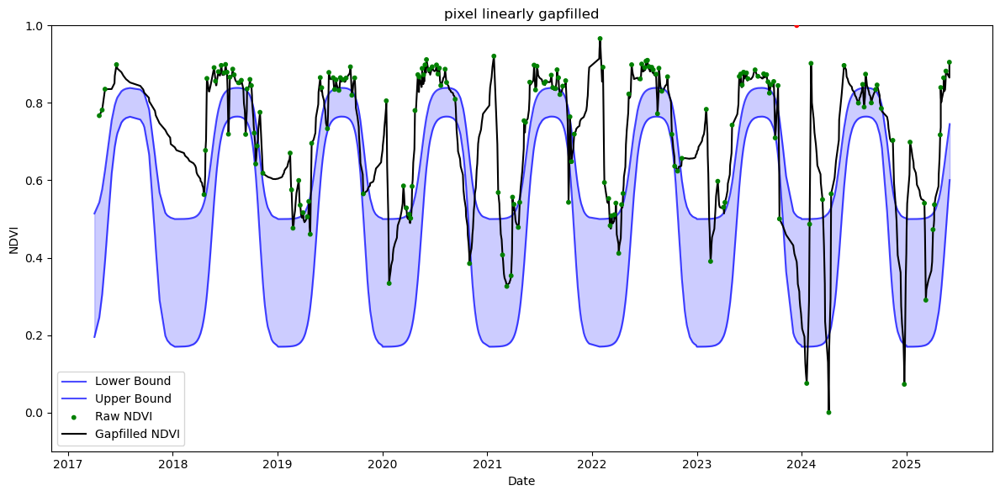

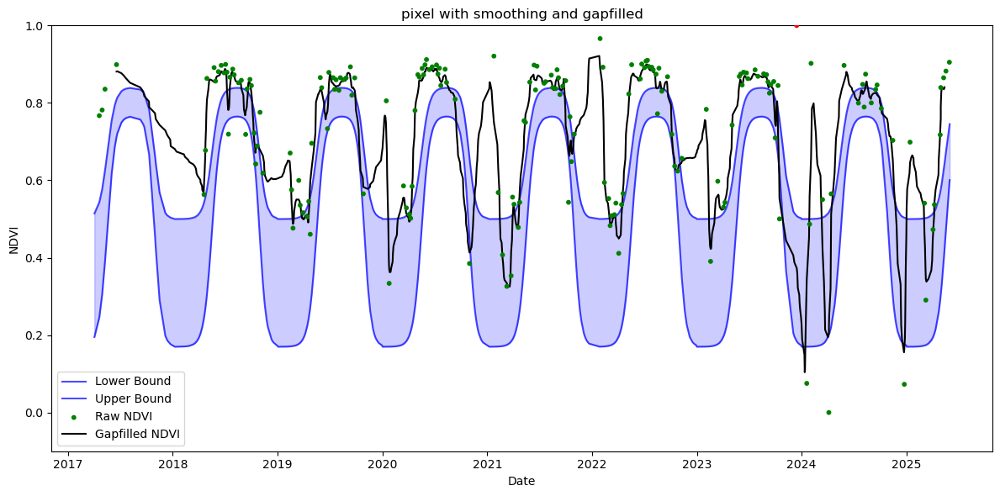

In [8]:
# fitting and smoothing
# ----- seasonal cycle fitting -----
ds = xr.open_zarr("../../sample_seasonal_cycle_parameter_preds.zarr")
ndvi = ds["ndvi"]
dates = ds["dates"]
params_lower = torch.tensor(ds["params_lower"].values)
params_upper = torch.tensor(ds["params_upper"].values)

# convert dates to doy
dates_pd = pd.to_datetime(dates)
df = pd.DataFrame({"date": dates_pd})
df_sorted = df.sort_values(by="date")
dates_sorted = df_sorted["date"].values
dates_pd_sorted = pd.to_datetime(dates_sorted)
doy = dates_pd_sorted.dayofyear.values
doy = torch.tensor(doy, dtype=torch.float32)
T_SCALE = 1.0 / 365.0
t = doy.unsqueeze(0).repeat(params_lower.shape[0], 1) * T_SCALE


lower = double_logistic_function(t[[0]], params_lower[[91]]).squeeze().cpu().numpy()
upper = double_logistic_function(t[[0]], params_upper[[91]]).squeeze().cpu().numpy()

median_iqr = upper - (upper - lower) / 2

param_iqr = 1.5
bottom_iqr = 0.9
upper_iqr = 0.1
window_length = 14
polyorder = 2


random_pixels = 113  # pick one pixel index to check

ndvi_series = z[random_pixels, :]

# proper sorting

df = pd.DataFrame({
    'date': dates_pd,
    'ndvi': ndvi_series
    })

df_sorted = df.sort_values(by='date')

ndvi_sorted = df_sorted['ndvi'].values

ndvi_gapfilled, outlier_arr = gapfill_ndvi(ndvi_sorted, lower, upper)

smoothed_data = savgol_filter(ndvi_gapfilled, window_length=window_length, polyorder=polyorder) 


plot_results(
        title= "pixel linearly gapfilled",
        pixel_idx=random_pixels,
        ndvi_series=ndvi_sorted / 10000.0,
        ndvi_gapfilled=ndvi_gapfilled,
        outlier_arr=outlier_arr,
        lower=lower,
        upper=upper,
        dates=dates_sorted
    )

plot_results(
        title= "pixel with smoothing and gapfilled",
        pixel_idx=random_pixels,
        ndvi_series=ndvi_sorted / 10000.0, 
        ndvi_gapfilled=smoothed_data,
        outlier_arr=outlier_arr,
        lower=lower,
        upper=upper,
        dates=dates_sorted
    )


# Gapfilling Strategy and Outlier Handling

## Band Overlap and Gapfilling Approach
To prevent unrealistic behavior, I choose to gapfill the values by:  

- Taking into consideration the **mean between the lower and upper bands**  
- Creating a **weight dependent on the distance** between the observation and the gapfilled point  

The further the gapfilled point is from the observed value, the **more the mean influences it**.  
This prevents spiking behavior and ensures a realistic representation of NDVI, which is further improved after smoothing.  

---

## Continous integration Mode
Here, we apply the same function as before but **toggle the forecasting flag to `true`**.  

The continuous gapfilling requires:  
- **Two integers**:  
  - Last known position  
  - Last potential known position  
- **Two floats**:  
  - Bottom quantile of delta between neighbors  
  - Upper quantile of delta between neighbors  

These quantiles determine when a point is considered an outlier.  

---

## Outlier Detection Logic
Each time a true value is assigned, the program checks whether the **last potential known position** is greater than the **last known position**.  

- **If true**:  
  - A potential outlier exists  
  - The delta between neighbors is calculated  
  - If the delta falls **outside the quantile range**, the point is flagged as an **outlier**  
  - Retroactive gapfilling is performed between:  
    - Last known position ↔ daily value  

- **If false**:  
  - The potential outlier is already resolved so there is no need to recalcuale it 
  - Retroactive gapfilling is performed between:  
    - Last known position ↔ potential last known position  
    - Last known position ↔ daily value  

The maximum amount of data which needs to be retroactively gapfilled at once is written at the end of the following code chunk

---

## Code Logic Overview
1. **New data enters**  
2. If it is **not `NaN`**:  
   - Check distance between bands + IQR  
   - If within range → mark as **true value**  
   - If outside range → check delta with previous neighbor  
     - If delta falls outside quantile range → flag as **outlier**  
     - Otherwise → flag as **true value**  
3. Once outlier detection is complete:  
   - If flagged as true value → retroactive gapfilling is applied as described above  
   - Update last known position or last potential known position depending on the flag  
4. If the entry is **`NaN`**:  
   - Assign a **forecasted value**  
   - Do so by calculating the delta of the last known position and assigning it  

---

## Smoothing
The delayed smoothing is performed using a **`savgol_filter`** with:  
- **Latency:** 14 days  
- **Window length:** 14 days  


In [ ]:
# continous gapfilling and smoothing
ndvi_filled, outlier_arr, forecast_only, smoothed = gapfill_ndvi(ndvi_sorted, lower, upper,forecasting=True,
                                                                param_iqr=1.5,
                                                                bottom_q=0.3,
                                                                top_q=0.7,
                                                                window_smoothing = window_length)

ndvi_timeseries = ndvi_sorted / 10000

# assign cloud mask as nan
ndvi_timeseries = np.where((ndvi_timeseries > 1) | (ndvi_timeseries < 0), np.nan, ndvi_timeseries)

valid_indices = np.where(~np.isnan(ndvi_timeseries))[0]

gaps = np.diff(valid_indices)
max_gap = np.max(gaps)
print("Maximum data that needs to be retroactively gapfilled at once:", max_gap)


Maximum gap between consecutive valid NDVI points: 39


# GIF Generation

This code will generate the **GIF** that shows the continuous data ingestion.  

- **Black line** → linear gapfilling  
- **Red line** → delayed smoothing  
- **Gray area** → window in which the smoothing is performed  


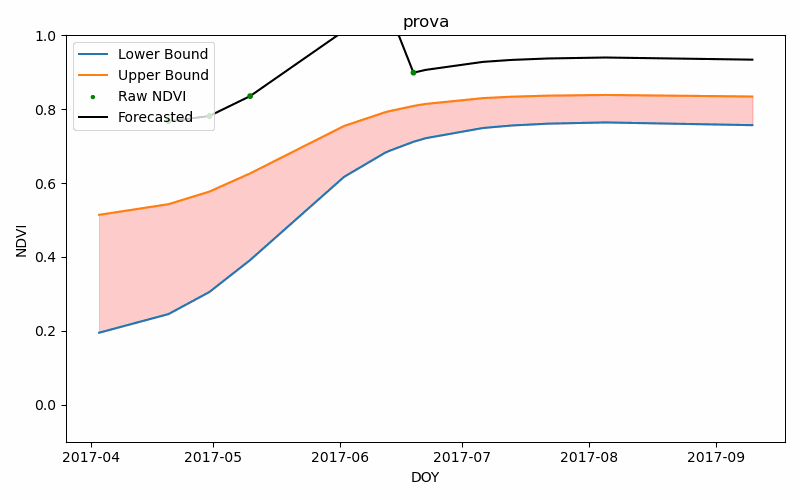

In [ ]:
frames = []

n = len(smoothed)

for t in range(window_length, n):
    fig, ax = plt.subplots(figsize=(8, 5))

    colors = np.where(outlier_arr[:t], "red", "green")


    ax.plot(dates_sorted[:t], lower[:t], label="Lower Bound")
    ax.plot(dates_sorted[:t], upper[:t], label="Upper Bound")
    ax.fill_between(dates_sorted[:t], lower[:t], upper[:t], alpha=0.2, color="red")
    ax.scatter(dates_sorted[:t], ndvi_timeseries[:t], s=10, color=colors[:t], label="Raw NDVI", zorder=3)

    # Smoothed data: t=14 to t-14
    if t > window_length:
        ax.plot(dates_sorted[window_length:t +1 -window_length], smoothed[window_length:t +1 -window_length], color="red", label="Smoothed")
        ax.fill_between(dates_sorted[t-window_length*2:t +1 -window_length], 0, 1, alpha=0.2, color="gray")


    # Forecasted data: t-13 to t
    ax.plot(dates_sorted[max(0,t+1 - window_length):t], forecast_only[max(0,t+1-window_length):t], color="black", label="Forecasted")

    ax.set_title("prova")
    ax.set_ylim(-0.1, 1)
    ax.set_xlabel("DOY")
    ax.set_ylabel("NDVI")
    ax.legend(loc="upper left")
    plt.tight_layout()

    # Save frame to memory
    buf = BytesIO()
    plt.savefig(buf, format="png", dpi=100)
    buf.seek(0)
    frames.append(imageio.v2.imread(buf))
    plt.close()

gif_filename = "continous_integration.gif"
imageio.mimsave(gif_filename, frames, duration=0.05)

# Display in notebook
display(Image(filename=gif_filename))